# First Homework Assignment - CompVis

Student: Adrian Willi (adrian.willi@hslu.ch)

In [77]:
import os
import skimage
import skimage.io
import skimage.feature
import skimage.transform.hough_transform as ht
from skimage import io
from skimage.color import rgb2gray
import matplotlib.pyplot as plt
import numpy as np

import ipywidgets as widgets

In [78]:
img_original = io.imread('original_images/IMG_20190312_183858.jpg')
img = rgb2gray(img_original)
img_resized = skimage.transform.resize(img, (img.shape[0] // 6, img.shape[1] // 6), anti_aliasing=True)

In [79]:
@widgets.interact(canny_sigma=(1,10), hough_threshold=(10,200,20))
def f(canny_sigma=3, hough_threshold=70):
    imedges = skimage.feature.canny(img_resized, sigma=canny_sigma)
    lines = ht.probabilistic_hough_line(imedges,
                                        threshold=hough_threshold,
                                        seed=0,
                                        line_gap=100,
                                        line_length=150)
    fig,(ax0,ax1) = plt.subplots(ncols=2, figsize=(12,8))
    ax0.imshow(img_resized,cmap="gray")
    for ((x0,y0),(x1,y1)) in lines:
        ax0.plot([x0,x1],[y0,y1],'b-')
    ax1.imshow(imedges,cmap="gray")

interactive(children=(IntSlider(value=3, description='canny_sigma', max=10, min=1), IntSlider(value=70, descri…

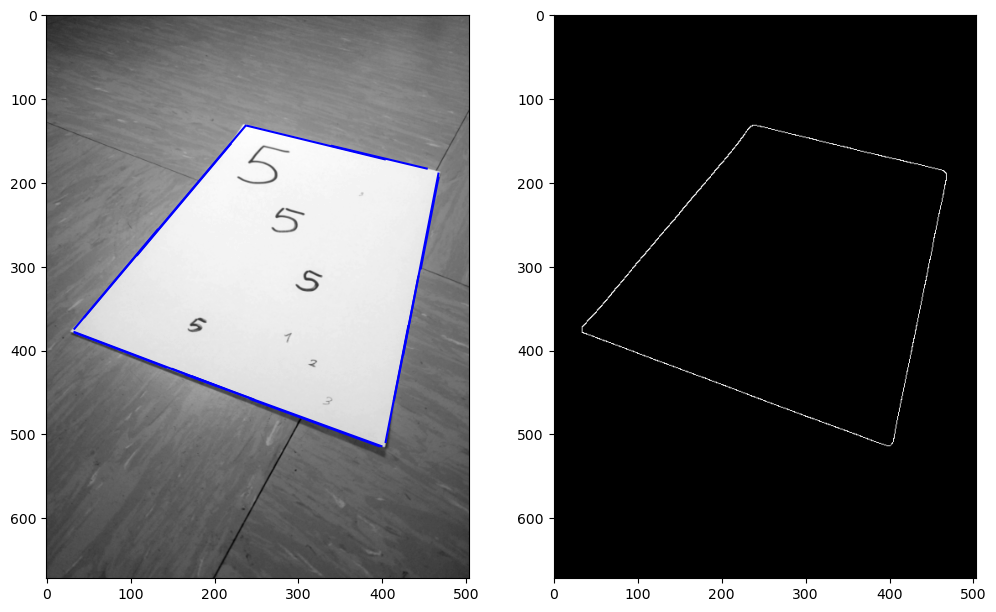

In [80]:
imedges = skimage.feature.canny(img_resized, sigma=4)
lines = ht.probabilistic_hough_line(imedges,
                                    threshold=100,
                                    seed=0)
fig,(ax0,ax1) = plt.subplots(ncols=2, figsize=(12,8))
ax0.imshow(img_resized,cmap="gray")
for ((x0,y0),(x1,y1)) in lines:
    ax0.plot([x0,x1],[y0,y1],'b-')
ax1.imshow(imedges,cmap="gray")

In [81]:
for ((x0,y0), (x1,y1)) in lines:
    print(x0,y0)

45 360
33 374
399 514
396 514
425 405
414 459
446 302
403 172
404 509
202 442
246 458
142 420
213 446
453 183
108 286


In [83]:
def show_images(images: list, rows: int = 5) -> None:
    """
    Display a list of images in a single figure
    
    :param images: List of np.arrays compatible with plt.imshow.    
    :param rows: Number of rows in figure
    :return: None
    """
    n_images = len(images)
    fig = plt.figure()
    for n, image in enumerate(images):
        a = fig.add_subplot(int(np.ceil(n_images/float(rows))), rows, n + 1)
        if image.ndim == 2:
            plt.gray()
        plt.imshow(image)
    fig.set_size_inches(np.array(fig.get_size_inches()) * n_images)
    plt.show()

In [84]:
imgs = []

for filename in os.listdir('original_images'):
    if filename.endswith('.jpg'):
        img = skimage.io.imread(os.path.join('original_images', filename), as_gray=True)
        img_resized = skimage.transform.resize(img, (img.shape[0] // 6, img.shape[1] // 6), anti_aliasing=True)
        if img_resized is not None:
            imgs.append(img_resized)

In [85]:
show_images(imgs)